# **Image Features Analysis**

In this notebook, we will consider how to extract features, rather than descriptors, from image. The features of interest would be:
- edges, 
- corners/ points, 
- lines, 
- keypoints, and 
- blobs



### Workspace utilities

In [1]:
import numpy as np
import skimage
from skimage import io
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
from matplotlib import cm
from skimage.feature import corner_harris, corner_peaks, canny
#from skimage.transform import hough_line, hough_line_peaks
from skimage.transform import probabilistic_hough_line

import glob
import cv2


### **Harris corner detector and hough line transform**
In the first part of this notebook, we will load an urban remote sensing image, extract the road junctions with **Harris detector** and compute the main road orientations with **Hough transform**,

##### Load image

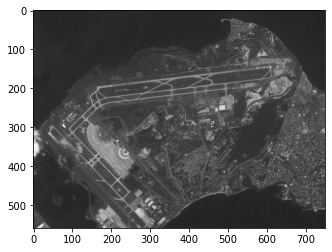

In [2]:
galileo = io.imread("./galeao.jpg")
gray_img = rgb2gray(galileo)
plt.imshow(gray_img, cmap = 'gray')

##### Extract the main road junction with harris detector

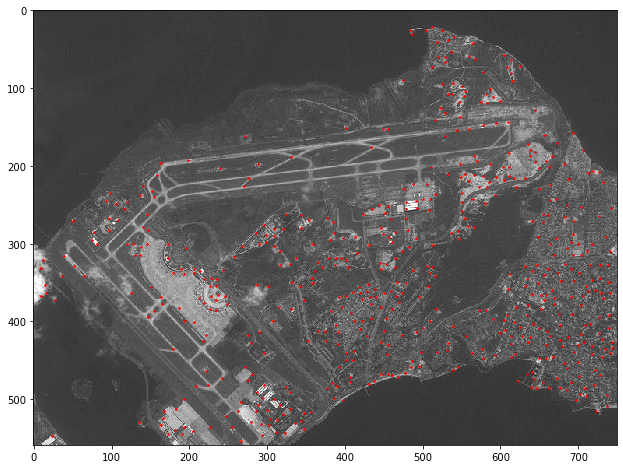

In [3]:
# Harris Corner Detection
coords = corner_peaks(corner_harris(gray_img), min_distance= 5, threshold_rel=0.008)

fig, ax = plt.subplots(figsize=(15, 8))
ax.imshow(galileo, interpolation='nearest', cmap=plt.cm.gray)
ax.plot(coords[:, 1], coords[:, 0], '.r', markersize=3)

##### Extract the main road orientation using Hough transform

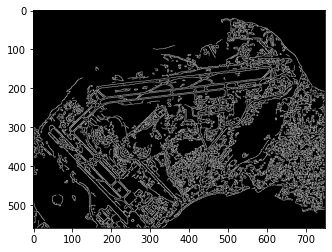

In [4]:
edges = canny(gray_img)
plt.imshow(edges, cmap=cm.gray)

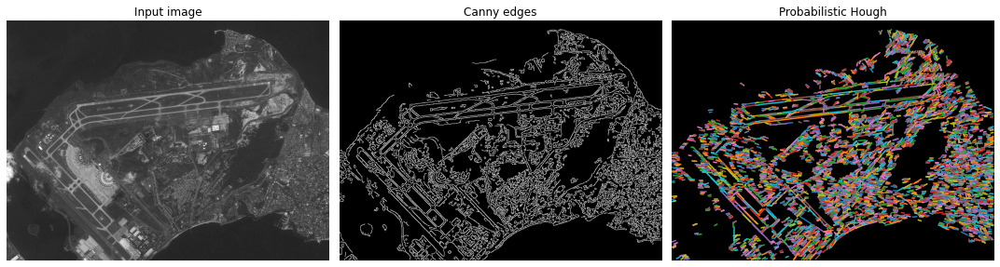

In [7]:
# Line finding using the Probabilistic Hough Transform
lines = probabilistic_hough_line(edges, threshold=10, line_length=5,
                                 line_gap=3)

# Plot the edges and Hough lines
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(gray_img, cmap=cm.gray)
ax[0].set_title('Input image')

ax[1].imshow(edges, cmap=cm.gray)
ax[1].set_title('Canny edges')

ax[2].imshow(edges * 0, cmap=cm.gray)
for line in lines:
    p0, p1 = line
    ax[2].plot((p0[0], p1[0]), (p0[1], p1[1]))
ax[2].set_xlim((0, gray_img.shape[1]))
ax[2].set_ylim((gray_img.shape[0], 0))
ax[2].set_title('Probabilistic Hough Lines')

for a in ax:
    a.set_axis_off()

plt.tight_layout()
plt.show()

### **Haralick feature extraction**

In this part of the notebook, we will work with the [UC Merced Land Use dataset](http://weegee.vision.ucmerced.edu/datasets/landuse.html), which is 21 class land use image dataset. 
- We selected randomly 10 images per class and computed the Haralick features for these images, 
- applied a basic retrieval scheme through computing features on an input image and looking for its nearest neighbors among the reference images. 

##### Randomly select 10 images per class and display them. 

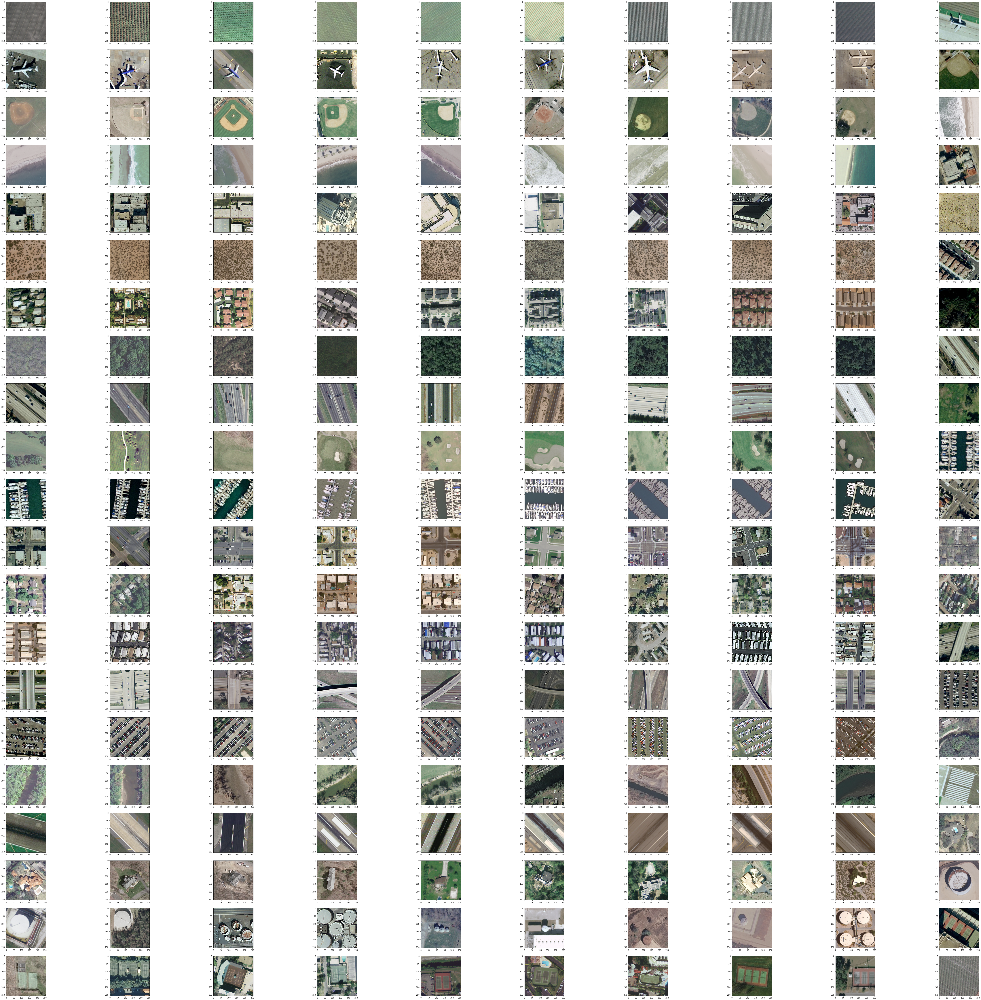

In [10]:
import os
import glob
import numpy as np

path = './UCMerced_LandUse/Images'

fig, axs = plt.subplots(21, 10, figsize = (100, 100))
files = glob.glob(path+"/**/*[1].tif", recursive=True)

for file, ax in zip(files, axs.ravel()):
  img = plt.imread(file)
  plt.imshow(img)
  plt.sca(ax =ax)
  

##### Compute the Haralick features for these randomly selected images

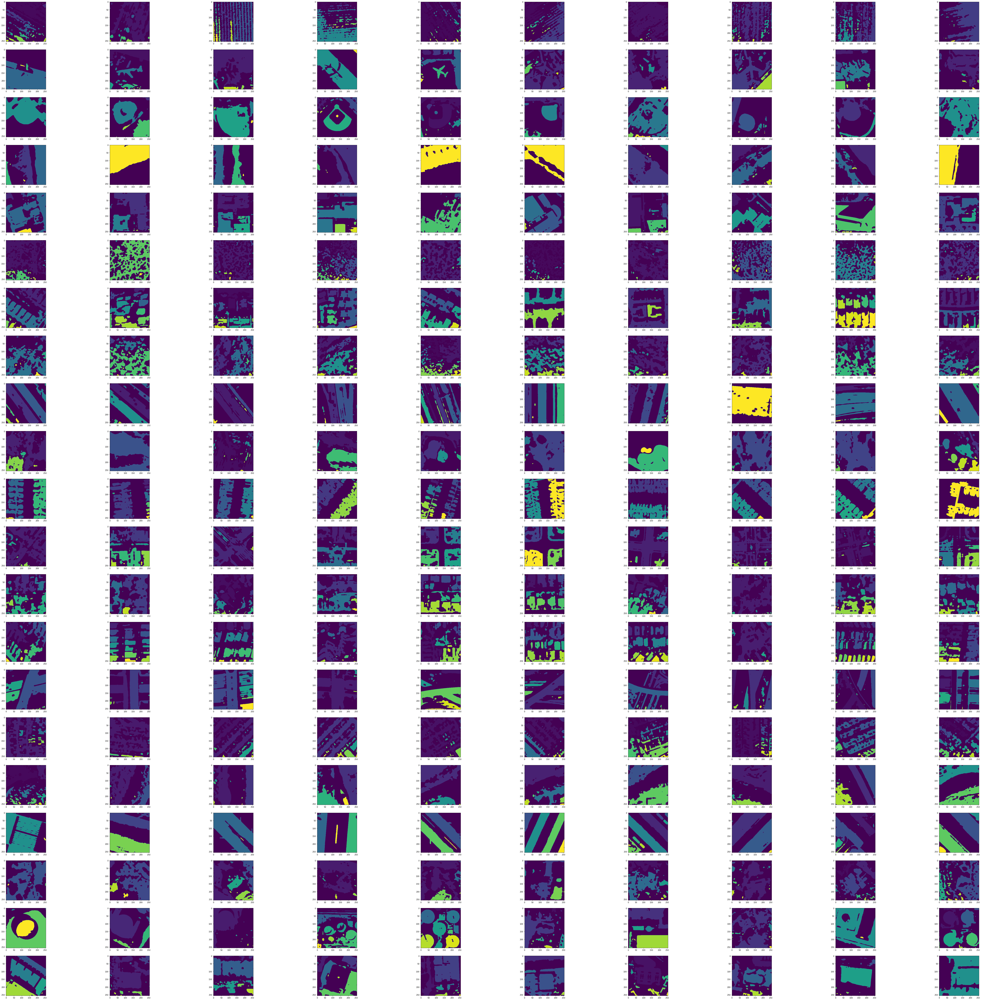

In [37]:
import numpy as np
import mahotas
from pylab import imshow, show

fig, axs = plt.subplots(21, 10, figsize = (100, 100))
for file, ax in zip(files, axs.ravel()):
  img = rgb2gray(plt.imread(file))
  gaussian = mahotas.gaussian_filter(img, 3)
  # setting threshold value
  gaussian = (gaussian > gaussian.mean())
  
  # making is labelled image
  labeled, n = mahotas.label(gaussian)
  h_feature = mahotas.features.haralick(labeled)
  plt.sca(ax =ax)
  plt.imshow(labeled)

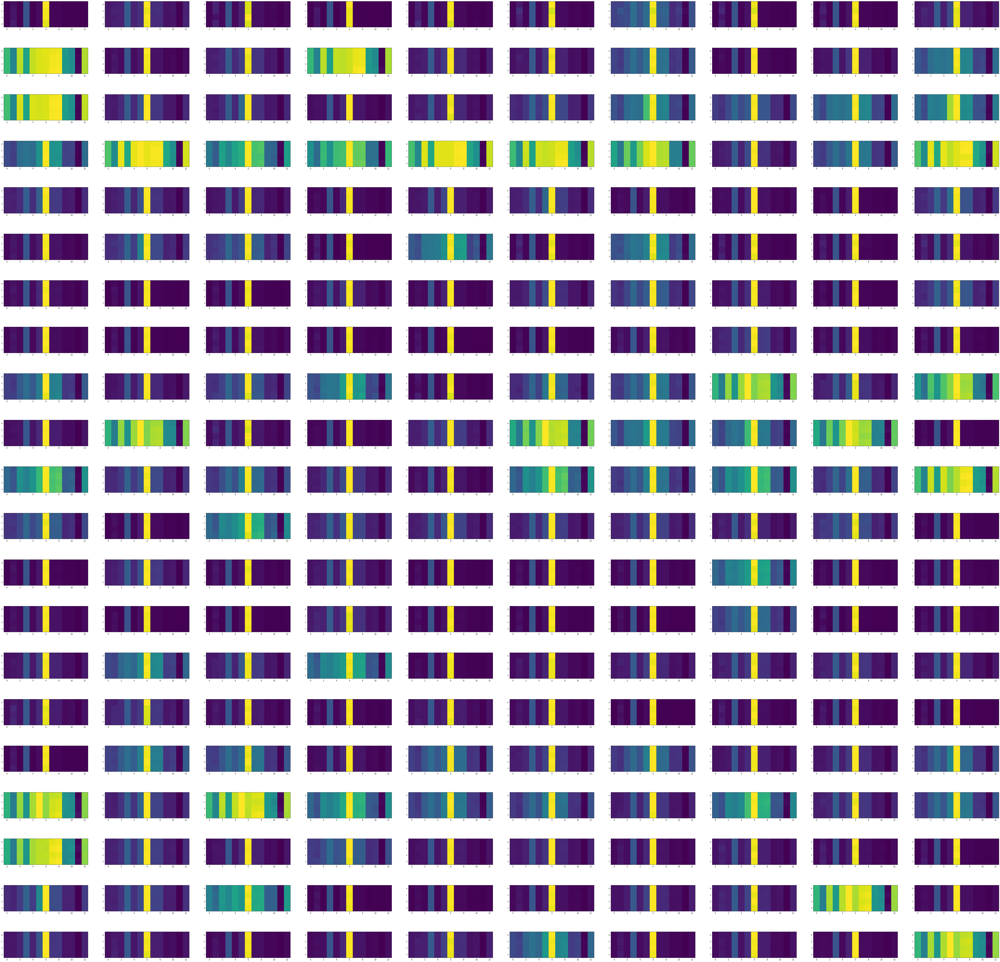

In [71]:
for file, ax in zip(files, axs.ravel()):
  img = rgb2gray(plt.imread(file))
  gaussian = mahotas.gaussian_filter(img, 3)
  # setting threshold value
  gaussian = (gaussian > gaussian.mean())
  
  # making is labelled image
  labeled, n = mahotas.label(gaussian)
  h_feature = mahotas.features.haralick(labeled)
  plt.sca(ax =ax)
  plt.imshow(h_feature)

##### Apply a retrieval scheme by computing features on an input image and looking for its nearest neighbors among reference images. 

In [103]:
# Developing the image retrieval schemes.   
# initialize the data matrix and the list of labels
print("[INFO] extracting features...")
data = []
labels = []
  
# loop over the dataset of images
for imagePath in glob.glob(path+"/**/*[1].tif", recursive=True):
    # load the image, convert it to grayscale, and extract the texture
    # name from the filename
    image = cv2.imread(imagePath)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    texture = imagePath[imagePath.rfind("\\") + 1:].split(".")[0]
    
    # extract Haralick texture features in 4 directions, then take the
    # mean of each direction
    features = mahotas.features.haralick(image).mean(axis=0)
  
    # update the data and labels
    data.append(features)
    labels.append(texture)

[INFO] extracting features...


In [172]:
data[0]

array([ 3.20542615e-04,  4.13057868e+02,  4.30358560e-01,  3.62613997e+02,
        6.86650286e-02,  2.38683575e+02,  1.03739812e+03,  7.00601306e+00,
        1.21794865e+01,  1.09109924e-04,  5.32772419e+00, -5.58607198e-02,
        6.72312664e-01])

For each image, we have 13 computed haralick features as seen in the array of features shown above. 

In [170]:
#update the labels and create the training and testing set for a classifier
from sklearn.model_selection import train_test_split
import re
labels = [re.split(r'(\d+)', s)[0] for s in labels]
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.3, random_state=42)

# Train a model to capture the the nearest neighbor in the test set.
from sklearn import neighbors
n_neighbors = 3
classifier = neighbors.NearestNeighbors(n_neighbors=n_neighbors).fit(X_train, y_train)
#y_pred = classifier.predict(X_test)
distances, indices = classifier.kneighbors(X_test)
print("Distances of Nearest Feature")
print(distances[:5])
print("Indices of Nearest Feature")
print(indices[:5])

[[221.07381675 234.95544385 236.4905147 ]
 [100.52552077 139.27457775 170.34163089]
 [ 48.23162984 141.86131049 153.16887245]
 [675.82490427 802.65471287 874.2649264 ]
 [350.11189544 438.13841531 808.29595241]]
[[ 20  10  12]
 [ 85  14 140]
 [110  45 112]
 [ 16 107  34]
 [ 16 107  34]]


In [166]:
def retrieveNN(img_path):
    image = cv2.imread(img_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    features = mahotas.features.haralick(image).mean(axis=0).reshape(1, -1)
    distances, indices = classifier.kneighbors(features)
    #return distances, indices\
    print("Distances of Nearest Feature")
    print(distances[:10])
    print("Indices of Nearest Feature")
    print(indices[:10])

retrieveNN(files[0])


Distance
[[  0.          61.20729258 332.54387538]]
Indices
[[59 97 74]]


This returns the 3 Nearest Neighbors of an image and their corresponding indices in the reference image database used to train the classifier. For the image we selected, we can see that the nearest image to the input image is at index 59 with a distance 0 from the image, followed by the image features at index 97 and a corresponding distance of 61.20. 